In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.fft import fft, ifft, fftfreq
from scipy.sparse import diags, eye, block_diag, csr_matrix
from IPython.display import HTML

class BlumelQuantumScatteringSolver:
    def __init__(self, L_total=120.0, N_points=1024, m=1.0, hbar=1.0, I_0=5.0, l_channels=None):
        self.L = L_total
        self.N = N_points
        self.m = m
        self.hbar = hbar
        self.I_0 = I_0
        self.dx = L_total / (N_points - 1)
        self.x = np.linspace(-L_total/2, L_total/2, N_points)
        self.dp = 2 * np.pi / L_total
        self.p = hbar * fftfreq(N_points, d=self.dx) * 2 * np.pi
        
        
        # Angular momentum channels
        if l_channels is None:
            self.l_channels = np.arange(-2, 3)  # [-2, -1, 0, 1, 2]
        else:
            self.l_channels = l_channels
        self.n_channels = len(self.l_channels)
        
        # State variables
        self.dt = None
        self.t = 0.0
        self.psi = None  # Shape: (n_channels, N_points)
        self.V_spatial = None
        self.psi_initial = None
        
        # Absorbing boundaries
        self.abc_width = int(N_points * 0.1)
        self.abc_strength = 0.02
        
        # Colors for different channels
        self.channel_colors = plt.cm.Set1(np.linspace(0, 1, self.n_channels))

    def create_blumel_potential(self, V0=3.0, xi=10.0):
        """Create Blümel-Smilansky potential: sum of 3 Gaussians"""
        positions = [-xi, 0.0, xi]  # Gaussian centers at -10, 0, +10
        self.V_spatial = np.sum([V0/2 * np.exp(-(self.x - pos)**2) 
                                for pos in positions], axis=0)
        return self.V_spatial

    def create_absorbing_boundaries(self):
        """Create absorbing boundary potential"""
        abs_pot = np.zeros(self.N, dtype=complex)
        # Left boundary
        for i in range(self.abc_width):
            factor = (self.abc_width - i) / self.abc_width
            abs_pot[i] = -1j * self.abc_strength * factor**2
        # Right boundary
        for i in range(self.N - self.abc_width, self.N):
            factor = (i - (self.N - self.abc_width - 1)) / self.abc_width
            abs_pot[i] = -1j * self.abc_strength * factor**2
        return abs_pot

    def initialize_incoming_wave(self, input_channel_l=0, E_real=0.5, x0=-40.0, sigma_x=6.0):
        """Initialize wavepacket in specific angular momentum channel"""
        
        input_idx = list(self.l_channels).index(input_channel_l)
        
        # Calculate momentum for this channel
        E_channel = E_real - self.hbar**2 * input_channel_l**2 / (2 * self.I_0)
        if E_channel <= 0:
            raise ValueError(f"Channel l={input_channel_l} is closed at E={E_real}")
        
        k0 = np.sqrt(2 * self.m * E_channel) / self.hbar
        
        # Create Gaussian wavepacket × plane wave
        wavepacket = (np.exp(-(self.x - x0)**2 / (4 * sigma_x**2)) * 
                     np.exp(1j * k0 * self.x))
        
        # Normalize
        norm = np.sqrt(np.trapz(np.abs(wavepacket)**2, self.x))
        # wavepacket = wavepacket / norm
        
        # Initialize multi-channel wavefunction
        self.psi = np.zeros((self.n_channels, self.N), dtype=complex)
        self.psi[input_idx, :] = wavepacket
        self.psi_initial = self.psi.copy()
        
        # Set stable time step
        dt_kinetic = 0.4 * self.m * self.dx**2 / self.hbar
        dt_potential = 0.1 * self.hbar / (np.max(self.V_spatial) + 1e-6)
        self.dt = min(dt_kinetic, dt_potential)
        self.dt = 0.01
        
        print(f"Initialized channel l={input_channel_l}, k={k0:.4f}, dt={self.dt:.6f}")
        return self.psi.copy()

    def split_operator_step(self):
        """Single time step using split-operator method for coupled channels"""
        
        # Step 1: Potential + rotational energy evolution (dt/2)
        abs_pot = self.create_absorbing_boundaries()
        for i, l in enumerate(self.l_channels):
            E_rot = self.hbar**2 * l**2 / (2 * self.I_0)
            total_potential = E_rot + abs_pot # + #self.V_spatial 
            self.psi[i, :] *= np.exp(-1j * total_potential * self.dt / (2 * self.hbar))
        
        # Step 2: Channel coupling evolution (dt/2)
        self.apply_coupling_evolution(self.dt / 2)
        
        # Step 3: Kinetic energy evolution (dt) - diagonal in momentum
        for i in range(self.n_channels):
            psi_k = fft(self.psi[i, :])
            kinetic_phase = np.exp(-1j * self.p**2 * self.dt / (2 * self.m * self.hbar))
            self.psi[i, :] = ifft(psi_k * kinetic_phase)
        
        # Step 4: Channel coupling evolution (dt/2)
        self.apply_coupling_evolution(self.dt / 2)
        
        # Step 5: Potential + rotational energy evolution (dt/2)
        for i, l in enumerate(self.l_channels):
            E_rot = self.hbar**2 * l**2 / (2 * self.I_0)
            total_potential = E_rot + abs_pot # + self.V_spatial 
            self.psi[i, :] *= np.exp(-1j * total_potential * self.dt / (2 * self.hbar))
        
        self.t += self.dt

    def apply_coupling_evolution(self, dt_step):
        """Apply V(x) * [ψ_{l+1} + ψ_{l-1}] coupling evolution"""
        psi_new = self.psi.copy()
        
        for i, l in enumerate(self.l_channels):
            coupling_source = np.zeros(self.N, dtype=complex)
            
            # Coupling to l+1 channel
            if l + 1 in self.l_channels:
                neighbor_idx = list(self.l_channels).index(l + 1)
                # coupling_sum += self.psi[neighbor_idx, :]
                coupling_source += self.psi[neighbor_idx, :]
                
            
            # Coupling to l-1 channel
            if l - 1 in self.l_channels:
                neighbor_idx = list(self.l_channels).index(l - 1)
                coupling_source += self.psi[neighbor_idx, :]
            
            # Apply time evolution: ψ_l += -i/ℏ * V * (ψ_{l-1} + ψ_{l+1}) * dt
            # Note: V_strength is already included in V_spatial
            psi_new[i, :] -= (1j * dt_step / self.hbar) * self.V_spatial * coupling_source
        
        self.psi = psi_new

    def evolve_with_snapshots(self, total_time, snapshot_interval=0.5):
        """Evolve system and collect snapshots for animation"""
        n_steps = int(total_time / self.dt)
        steps_per_snapshot = max(1, int(snapshot_interval / self.dt))
        snapshots = []
        times = []
        
        print(f"Evolving for {total_time} time units, {n_steps} steps...")
        
        for step in range(n_steps):
            self.split_operator_step()
            
            if step % steps_per_snapshot == 0:
                snapshots.append(self.psi.copy())
                times.append(self.t)
                
            if step % (n_steps // 10) == 0:
                norm = np.sum([np.trapz(np.abs(self.psi[i, :])**2, self.x) 
                              for i in range(self.n_channels)])
                print(f"  Step {step}/{n_steps}, t={self.t:.2f}, norm={norm:.6f}")
                
        return np.array(times), np.array(snapshots)

    def analyze_channel_transmission(self):
        """Calculate transmission and reflection for each channel"""
        results = {}
        
        # Define asymptotic regions
        left_mask = self.x < -20.0
        right_mask = self.x > 20.0
        left_mask_2 = self.x < -30.0
        
        def current(psi_1d, x_grid):
            """Calculate probability current for 1D wavefunction"""
            dpsi = np.gradient(psi_1d, x_grid[1] - x_grid[0])
            return (self.hbar / self.m) * np.imag(np.conj(psi_1d) * dpsi)
        J_initial = 0.0
        for i, l in enumerate(self.l_channels):
            J_initial += np.mean((current(self.psi_initial[i, left_mask], self.x[left_mask])))
            
        print(f"J_incident = {J_initial:.6f}")
        
        for i, l in enumerate(self.l_channels):
            # Calculate currents
            J_left = np.mean((current(self.psi[i, left_mask], self.x[left_mask])))
            J_right = np.mean((current(self.psi[i, right_mask], self.x[right_mask])))

            
            print(f"l = {l}, J_left = {J_left:.6f}")
            print(f"l = {l}, J_right = {J_right:.6f}")
            
            if J_initial > 1e-12:
                T = abs(J_right) / J_initial
                R = abs(J_left) / J_initial
            else:
                T = abs(J_right) if np.max(np.abs(self.psi_initial[i, :])) < 1e-12 else 0
                R = 0
            
            results[l] = {'T': T, 'R': R, 'conservation': T + R}
            
        return results

# Visualization functions
def plot_initial_state(solver):
    """Plot initial multi-channel wavefunction and potential"""
    plt.figure(figsize=(15, 10))
    
    # Plot potential
    plt.subplot(2, 2, 1)
    plt.plot(solver.x, solver.V_spatial, 'k-', linewidth=2)
    plt.xlabel('Position x')
    plt.ylabel('V(x)')
    plt.title('Blümel-Smilansky Potential')
    plt.grid(True)
    
    # Plot initial probability densities for each channel
    plt.subplot(2, 2, 2)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi_initial[i, :])) > 1e-8:
            plt.plot(solver.x, np.abs(solver.psi_initial[i, :])**2, 
                    color=solver.channel_colors[i], linewidth=2, label=f'|ψ_{l}|²')
    plt.xlabel('Position x')
    plt.ylabel('|ψ(x)|²')
    plt.title('Initial Probability Densities')
    plt.legend()
    plt.grid(True)
    
    # Plot initial real parts
    plt.subplot(2, 2, 3)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi_initial[i, :])) > 1e-8:
            plt.plot(solver.x, np.real(solver.psi_initial[i, :]), 
                    color=solver.channel_colors[i], linewidth=2, label=f'Re[ψ_{l}]')
    plt.xlabel('Position x')
    plt.ylabel('Re[ψ(x)]')
    plt.title('Initial Real Parts')
    plt.legend()
    plt.grid(True)
    
    # Plot channel energies
    plt.subplot(2, 2, 4)
    channel_energies = [solver.hbar**2 * l**2 / (2 * solver.I_0) for l in solver.l_channels]
    plt.bar(range(len(solver.l_channels)), channel_energies, 
           color=solver.channel_colors, alpha=0.7)
    plt.xlabel('Channel index')
    plt.ylabel('Rotational Energy')
    plt.title('Channel Energies')
    plt.xticks(range(len(solver.l_channels)), [f'l={l}' for l in solver.l_channels])
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

def create_blumel_animation(solver, times, snapshots):
    """Create multi-channel animation"""
    plt.rcParams['animation.embed_limit'] = 70
    
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))
    
    # Initialize plot elements for probability densities
    lines_prob = []
    for i, l in enumerate(solver.l_channels):
        line, = ax1.plot(solver.x, np.abs(snapshots[0][i, :])**2, 
                        color=solver.channel_colors[i], linewidth=2, label=f'|ψ_{l}|²')
        lines_prob.append(line)
    
    # Plot potential
    ax1.plot(solver.x, solver.V_spatial, 'k--', alpha=0.5, label='V(x)/')
    ax1.set_xlim(solver.x[0], solver.x[-1])
    ax1.set_ylim(0, 0.2)
    ax1.set_ylabel('|ψ(x)|²')
    ax1.set_title(f'Multi-Channel Probability Densities - Time = {times[0]:.2f}')
    ax1.legend(loc='upper right')
    ax1.grid(True)
    
    # Initialize plot elements for real parts
    lines_real = []
    for i, l in enumerate(solver.l_channels):
        line, = ax2.plot(solver.x, np.real(snapshots[0][i, :]), 
                        color=solver.channel_colors[i], linewidth=2, label=f'Re[ψ_{l}]')
        lines_real.append(line)
    
    ax2.set_xlim(solver.x[0], solver.x[-1])
    ax2.set_ylim(-0.3, 0.3)
    ax2.set_xlabel('Position x')
    ax2.set_ylabel('Re[ψ(x)]')
    ax2.set_title('Real Parts of Wavefunctions')
    ax2.grid(True)

    def update(frame):
        # Update probability densities
        for i, line in enumerate(lines_prob):
            line.set_ydata(np.abs(snapshots[frame][i, :])**2)
        
        # Update real parts
        for i, line in enumerate(lines_real):
            line.set_ydata(np.real(snapshots[frame][i, :]))
        
        ax1.set_title(f'Multi-Channel Probability Densities - Time = {times[frame]:.2f}')
        
        return lines_prob + lines_real

    ani = FuncAnimation(fig, update, frames=len(times), interval=100, blit=True)
    plt.close()
    return HTML(ani.to_jshtml())

def plot_final_analysis(solver):
    """Plot final state analysis for all channels"""
    plt.figure(figsize=(15, 12))
    
    # Final probability densities
    plt.subplot(3, 2, 1)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi[i, :])) > 1e-8:
            plt.plot(solver.x, np.abs(solver.psi[i, :])**2, 
                    color=solver.channel_colors[i], linewidth=2, label=f'|ψ_{l}|²')
    plt.plot(solver.x, solver.V_spatial/10, 'k--', alpha=0.5, label='V(x)/10')
    plt.xlabel('Position x')
    plt.ylabel('|ψ(x)|²')
    plt.title('Final Probability Densities')
    plt.legend()
    plt.grid(True)
    
    # Final real parts
    plt.subplot(3, 2, 2)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi[i, :])) > 1e-8:
            plt.plot(solver.x, np.real(solver.psi[i, :]), 
                    color=solver.channel_colors[i], linewidth=2, label=f'Re[ψ_{l}]')
    plt.xlabel('Position x')
    plt.ylabel('Re[ψ(x)]')
    plt.title('Final Real Parts')
    plt.legend()
    plt.grid(True)
    
    # Phase analysis
    plt.subplot(3, 2, 3)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi[i, :])) > 1e-8:
            phase = np.angle(solver.psi[i, :])
            plt.plot(solver.x, phase, color=solver.channel_colors[i], 
                    linewidth=2, label=f'Phase ψ_{l}')
    plt.xlabel('Position x')
    plt.ylabel('Phase (radians)')
    plt.title('Final Phases')
    plt.legend()
    plt.grid(True)
    
    # Current densities
    plt.subplot(3, 2, 4)
    for i, l in enumerate(solver.l_channels):
        if np.max(np.abs(solver.psi[i, :])) > 1e-8:
            dpsi_dx = np.gradient(solver.psi[i, :], solver.dx)
            current = (solver.hbar / solver.m) * np.imag(np.conj(solver.psi[i, :]) * dpsi_dx)
            plt.plot(solver.x, current, color=solver.channel_colors[i], 
                    linewidth=2, label=f'J_{l}')
            dpsi_dx_in = np.gradient(solver.psi_initial[i, :], solver.dx)
            current_in = (solver.hbar / solver.m) * np.imag(np.conj(solver.psi_initial[i, :]) * dpsi_dx_in)
            plt.plot(solver.x, current_in,  
                    linewidth=2, label=f'J_{l} initial')
            
    plt.xlabel('Position x')
    plt.ylabel('Current density')
    plt.title('Probability Currents')
    plt.legend()
    plt.grid(True)
    
    # Highlight asymptotic regions
    plt.axvspan(-40, -20, alpha=0.1, color='red', label='Reflection Region')
    plt.axvspan(20, 40, alpha=0.1, color='green', label='Transmission Region')
    
    # Channel populations
    plt.subplot(3, 2, 5)
    populations = []
    for i, l in enumerate(solver.l_channels):
        pop = np.trapz(np.abs(solver.psi[i, :])**2, solver.x)
        populations.append(pop)
    
    plt.bar(range(len(solver.l_channels)), populations, 
           color=solver.channel_colors, alpha=0.7)
    plt.xlabel('Channel')
    plt.ylabel('Population')
    plt.title('Final Channel Populations')
    plt.xticks(range(len(solver.l_channels)), [f'l={l}' for l in solver.l_channels])
    plt.grid(True)
    
    # Transmission analysis
    results = solver.analyze_channel_transmission()
    plt.subplot(3, 2, 6)
    channels = list(results.keys())
    T_values = [results[l]['T'] for l in channels]
    R_values = [results[l]['R'] for l in channels]
    
    x_pos = np.arange(len(channels))
    plt.bar(x_pos - 0.2, T_values, 0.4, label='Transmission', alpha=0.7)
    plt.bar(x_pos + 0.2, R_values, 0.4, label='Reflection', alpha=0.7)
    plt.xlabel('Channel')
    plt.ylabel('Coefficient')
    plt.title('Transmission & Reflection Coefficients')
    plt.xticks(x_pos, [f'l={l}' for l in channels])
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()
    
    return results



In [4]:
print("Generating animation...")
animation_html = create_blumel_animation(solver, times, snapshots)
display(animation_html)

Generating animation...


🚀 BLÜMEL-SMILANSKY MULTI-CHANNEL SCATTERING SIMULATION 🚀
Initializing wavefunction...
Initialized channel l=0, k=1.7321, dt=0.010000


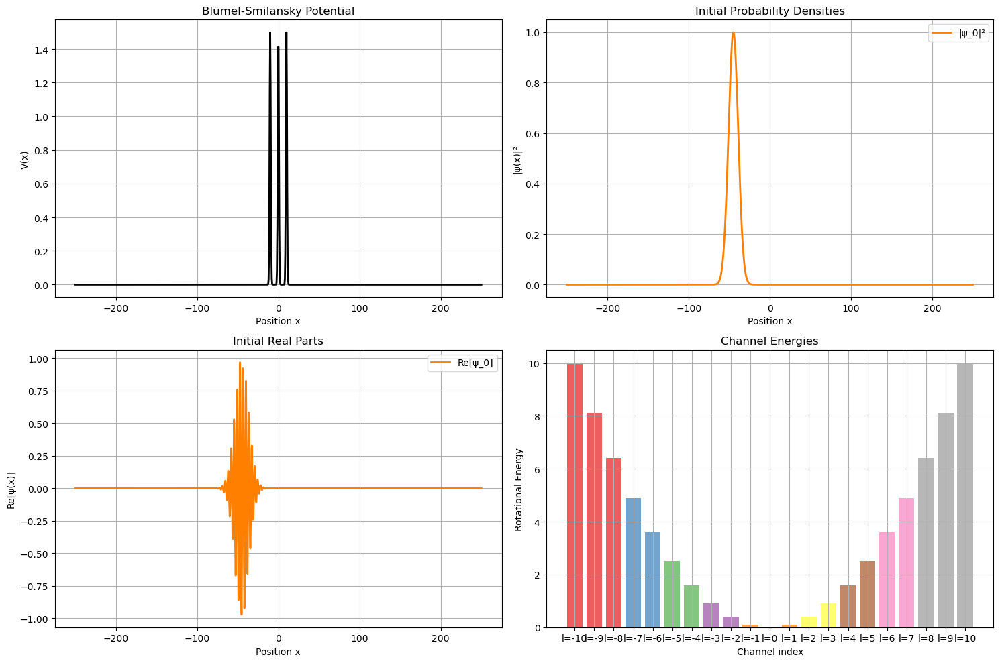

Running multi-channel quantum evolution...
Evolving for 90.0 time units, 9000 steps...
  Step 0/9000, t=0.01, norm=15.039770
  Step 900/9000, t=9.01, norm=15.039889
  Step 1800/9000, t=18.01, norm=15.090949
  Step 2700/9000, t=27.01, norm=15.338313
  Step 3600/9000, t=36.01, norm=15.503487
  Step 4500/9000, t=45.01, norm=15.554813
  Step 5400/9000, t=54.01, norm=15.573080
  Step 6300/9000, t=63.01, norm=15.587471
  Step 7200/9000, t=72.01, norm=15.600113
  Step 8100/9000, t=81.01, norm=15.609330
Analyzing final state...
J_incident = 0.100034
l = -10, J_left = -0.000000
l = -10, J_right = 0.000000
l = -9, J_left = -0.000000
l = -9, J_right = 0.000000
l = -8, J_left = -0.000000
l = -8, J_right = 0.000000
l = -7, J_left = -0.000000
l = -7, J_right = 0.000000
l = -6, J_left = -0.000000
l = -6, J_right = 0.000000
l = -5, J_left = -0.000000
l = -5, J_right = 0.000000
l = -4, J_left = -0.000062
l = -4, J_right = 0.000022
l = -3, J_left = -0.004408
l = -3, J_right = 0.002057
l = -2, J_left = -

C:\Users\Kaustubh\AppData\Local\Temp\ipykernel_16940\2011186445.py:414: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


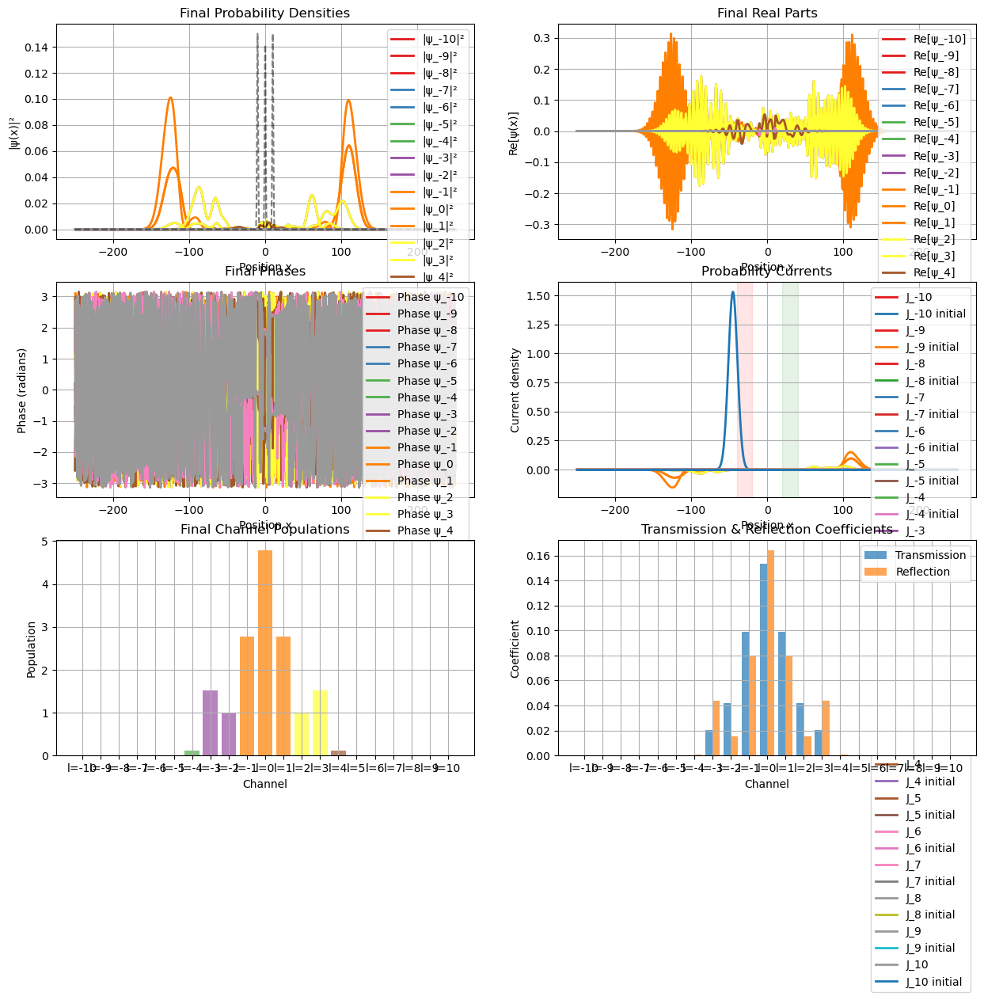


MULTI-CHANNEL SCATTERING RESULTS:
Channel l=-10: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-9: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-8: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-7: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-6: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-5: T=0.0000, R=0.0000, Conservation=0.0000
Channel l=-4: T=0.0002, R=0.0006, Conservation=0.0008
Channel l=-3: T=0.0206, R=0.0441, Conservation=0.0646
Channel l=-2: T=0.0422, R=0.0152, Conservation=0.0574
Channel l=-1: T=0.0987, R=0.0802, Conservation=0.1789
Channel l= 0: T=0.1535, R=0.1639, Conservation=0.3174
Channel l= 1: T=0.0987, R=0.0802, Conservation=0.1789
Channel l= 2: T=0.0422, R=0.0152, Conservation=0.0574
Channel l= 3: T=0.0206, R=0.0441, Conservation=0.0646
Channel l= 4: T=0.0002, R=0.0006, Conservation=0.0008
Channel l= 5: T=0.0000, R=0.0000, Conservation=0.0000
Channel l= 6: T=0.0000, R=0.0000, Conservation=0.0000
Channel l= 7: T=0.0000, R=0.0000, Conservation

In [2]:
# Main simulation
print("🚀 BLÜMEL-SMILANSKY MULTI-CHANNEL SCATTERING SIMULATION 🚀")
print("=" * 60)

# Initialize solver
solver = BlumelQuantumScatteringSolver(
    L_total=500.0, 
    N_points=1024, 
    l_channels=np.arange(-10, 11)
)

# Create Blümel potential
solver.create_blumel_potential(V0=3.0, xi=10.0)

# Initialize wavefunction in l=0 channel
print("Initializing wavefunction...")
psi_initial = solver.initialize_incoming_wave(
    input_channel_l=0, 
    E_real=1.5, 
    x0=-45.0, 
    sigma_x=6.0
)

# Plot initial state
plot_initial_state(solver)

# Run simulation with snapshots
print("Running multi-channel quantum evolution...")
times, snapshots = solver.evolve_with_snapshots(total_time=90.0, snapshot_interval=0.5)

# Create and display animation
# print("Generating animation...")
# animation_html = create_blumel_animation(solver, times, snapshots)
# Uncomment to display animation in Jupyter:
# display(animation_html)

# Plot final analysis
print("Analyzing final state...")
transmission_results = plot_final_analysis(solver)

# Print results
print(f"\n{'='*60}")
print("MULTI-CHANNEL SCATTERING RESULTS:")
print("=" * 60)

for l, result in transmission_results.items():
    print(f"Channel l={l:2d}: T={result['T']:.4f}, R={result['R']:.4f}, "
          f"Conservation={result['conservation']:.4f}")

# Total conservation check
total_T = sum(result['T'] for result in transmission_results.values())
total_R = sum(result['R'] for result in transmission_results.values())
print(f"\nTotal: T_total={total_T:.4f}, R_total={total_R:.4f}, "
      f"Total_conservation={total_T + total_R:.4f}")

print("\n✓ Simulation complete! Animation shows multi-channel scattering dynamics.")
print("✓ Different colors represent different angular momentum channels.")
print("✓ Observe channel coupling and energy redistribution during scattering!")


Computing S-matrix at E=1.500
Initialized channel l=0, k=1.7321, dt=0.010000
Evolving for 90.0 time units, 9000 steps...
  Step 0/9000, t=0.01, norm=15.039770
  Step 900/9000, t=9.01, norm=15.039889
  Step 1800/9000, t=18.01, norm=15.090949
  Step 2700/9000, t=27.01, norm=15.338313
  Step 3600/9000, t=36.01, norm=15.503487
  Step 4500/9000, t=45.01, norm=15.554813
  Step 5400/9000, t=54.01, norm=15.573080
  Step 6300/9000, t=63.01, norm=15.587471
  Step 7200/9000, t=72.01, norm=15.600113
  Step 8100/9000, t=81.01, norm=15.609330
J_incident = 0.100034
l = -10, J_left = -0.000000
l = -10, J_right = 0.000000
l = -9, J_left = -0.000000
l = -9, J_right = 0.000000
l = -8, J_left = -0.000000
l = -8, J_right = 0.000000
l = -7, J_left = -0.000000
l = -7, J_right = 0.000000
l = -6, J_left = -0.000000
l = -6, J_right = 0.000000
l = -5, J_left = -0.000000
l = -5, J_right = 0.000000
l = -4, J_left = -0.000062
l = -4, J_right = 0.000022
l = -3, J_left = -0.004408
l = -3, J_right = 0.002057
l = -2, J

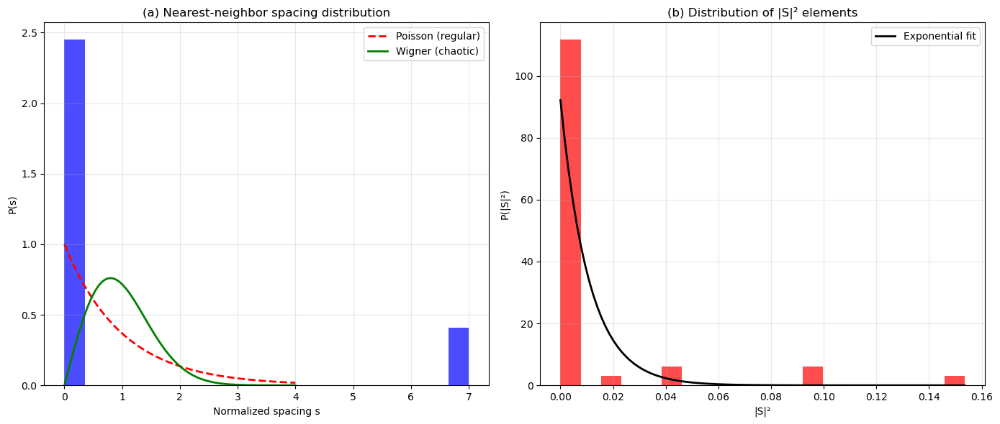

In [3]:
# Cell 1: S-matrix computation function
def compute_s_matrix(solver, E_real, input_channel_l=0):
    """
    Compute S-matrix for a specific energy and input channel
    Returns: S_matrix (complex array), open_channels (list)
    """
    # Reset solver for new energy
    solver.psi = None
    solver.t = 0.0
    
    # Initialize wavefunction
    try:
        psi_initial = solver.initialize_incoming_wave(
            input_channel_l=input_channel_l,
            E_real=E_real,
            x0=-45.0,
            sigma_x=6.0
        )
    except ValueError as e:
        print(f"Skipping E={E_real:.3f}: {str(e)}")
        return None, None
    
    # Run simulation
    _, _ = solver.evolve_with_snapshots(total_time=90.0, snapshot_interval=0.5)
    
    # Analyze transmission to get amplitudes
    results = solver.analyze_channel_transmission()
    
    # Determine open channels
    open_channels = []
    for l in solver.l_channels:
        E_rot = solver.hbar**2 * l**2 / (2 * solver.I_0)
        if E_real > E_rot:
            open_channels.append(l)
    
    # Build S-matrix (transmission amplitudes)
    n_open = len(open_channels)
    S_matrix = np.zeros((n_open, n_open), dtype=complex)
    
    # For now, we'll focus on transmission from input channel to all channels
    # (Full S-matrix would require multiple runs with different input channels)
    for j, l_out in enumerate(open_channels):
        if l_out in results:
            # Approximate S-matrix element as sqrt(transmission)
            # More accurate would be to store complex amplitudes during analysis
            S_matrix[j, 0] = np.sqrt(results[l_out]['T'])
    
    return S_matrix, open_channels

# Cell 2: Collect S-matrices at multiple energies
def collect_s_matrices(energy_list, l_channels = np.arange(-2,3)):
    """Collect S-matrices at multiple energies"""
    S_matrices = []
    all_energies = []
    all_open_channels = []
    
    for E in energy_list:
        print(f"Computing S-matrix at E={E:.3f}")
        solver = BlumelQuantumScatteringSolver(
            L_total=500.0, 
            N_points=1024, 
            l_channels= l_channels #np.arange(-2, 3)
        )
        solver.create_blumel_potential(V0=3.0, xi=10.0)
        
        S_mat, open_channels = compute_s_matrix(solver, E)
        
        if S_mat is not None and S_mat.size > 0:
            S_matrices.append(S_mat)
            all_energies.append(E)
            all_open_channels.append(open_channels)
            print(f"  S-matrix computed with {len(open_channels)} open channels")
    
    return S_matrices, all_energies, all_open_channels

# Cell 3: Statistical analysis functions
def extract_s_matrix_statistics(S_matrices):
    """Extract statistics from S-matrices for RMT analysis"""
    all_eigenvalues = []
    all_s_squared = []
    
    for S_mat in S_matrices:
        # Compute eigenvalues
        eigvals = np.linalg.eigvals(S_mat)
        all_eigenvalues.extend(eigvals)
        
        # Collect |S|² elements (off-diagonal)
        n = S_mat.shape[0]
        for i in range(n):
            for j in range(n):
                if i != j:  # Off-diagonal elements
                    all_s_squared.append(np.abs(S_mat[i,j])**2)
    
    # Extract eigenvalue phases
    phases = np.angle(all_eigenvalues)
    phases = np.mod(phases, 2*np.pi)  # Wrap to [0, 2π]
    
    # Sort phases and compute spacings
    phases_sorted = np.sort(phases)
    spacings = np.diff(phases_sorted)
    
    # Add wrap-around spacing
    spacings = np.append(spacings, 2*np.pi - phases_sorted[-1] + phases_sorted[0])
    
    # Normalize spacings
    mean_spacing = np.mean(spacings)
    normalized_spacings = spacings / mean_spacing
    
    return normalized_spacings, np.array(all_s_squared)

# Cell 4: Reproduce Figure 3
def plot_figure_3_reproduction(spacings, s_squared_values):
    """Reproduce Figure 3 from Blümel's 1988 paper"""
    plt.figure(figsize=(14, 6))
    
    # Panel (a): Nearest-neighbor spacing distribution
    plt.subplot(121)
    plt.hist(spacings, bins=20, density=True, alpha=0.7, color='blue')
    
    # Theoretical distributions
    s = np.linspace(0, 4, 100)
    P_poisson = np.exp(-s)  # Poisson distribution (regular systems)
    P_wigner = (np.pi/2)*s*np.exp(-np.pi*s**2/4)  # Wigner distribution (chaotic)
    
    plt.plot(s, P_poisson, 'r--', linewidth=2, label='Poisson (regular)')
    plt.plot(s, P_wigner, 'g-', linewidth=2, label='Wigner (chaotic)')
    plt.xlabel('Normalized spacing s')
    plt.ylabel('P(s)')
    plt.title('(a) Nearest-neighbor spacing distribution')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Panel (b): |S|² distribution
    plt.subplot(122)
    plt.hist(s_squared_values, bins=20, density=True, alpha=0.7, color='red')
    
    # Exponential distribution (expected for chaotic systems)
    x = np.linspace(0, np.max(s_squared_values), 100)
    mean_val = np.mean(s_squared_values)
    P_exponential = np.exp(-x/mean_val)/mean_val
    
    plt.plot(x, P_exponential, 'k-', linewidth=2, label='Exponential fit')
    plt.xlabel('|S|²')
    plt.ylabel('P(|S|²)')
    plt.title('(b) Distribution of |S|² elements')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

# Cell 5: Main analysis workflow
# Define energy range (1.5-2.3 as in paper)
energy_range = np.linspace(1.5, 2.3, 1)  # 10 energies for statistics

# Collect S-matrices
S_matrices, energies, open_channels = collect_s_matrices(energy_range, l_channels=np.arange(-10, 11))

# Extract statistics
spacings, s_squared = extract_s_matrix_statistics(S_matrices)

# Reproduce Figure 3
plot_figure_3_reproduction(spacings, s_squared)
